#  CV Homework 3 — Stereo Vision, Depth & Object Size Estimation

---

##  Overview
In this homework, you will build your own **stereo camera setup** using two webcameras or smartphones, perform **stereo calibration**, compute **depth maps**, detect **humans using YOLO**, and estimate **real-world distances** and **object sizes**.

---

### Important Notes
- You **must capture your own stereo images**.  
- Disable autofocus on your cameras and fix the focal length for all the captured images.  
- Keep cameras static during capture.  
- Capture a **checkerboard calibration dataset** and **scene images** with people and a reference object (cup).

---

## Goals
1. Calibrate a stereo camera using OpenCV.
2. Compute disparity and depth maps.
3. Detect humans with YOLO.
4. Estimate distances to humans.
5. Estimate a person’s height using a known-size reference object (cup).

---


## Part I — Stereo Camera Calibration

###  Task 1: Capture Checkerboard Images (5%)
Capture **N pairs** of checkerboard images using your stereo setup (more than 10 pairs for better results).

- The checkerboard must be visible from both cameras.  
- Save images as `left01.jpg`, `right01.jpg`, `left02.jpg`, `right02.jpg`, ...  


In [1]:

# TODO: Capture and store stereo images with a visible checkerboard.
# Example filenames: left01.jpg, right01.jpg, left02.jpg, right02.jpg, ...
# Make sure to fix exposure and disable autofocus for consistent images.


##download datasets

In [2]:
# Install gdown
!pip install -q gdown

# Google Drive file link
file_id = "1qEcd9rks2h1ndzw96T5TK2y3TGb3Li4E"
output = "dataset.zip"

# Download the zip file
!gdown --id $file_id -O $output

# Unzip the contents
!unzip -q dataset.zip -d /content/dataset

# Verify structure
!ls /content/dataset


/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1qEcd9rks2h1ndzw96T5TK2y3TGb3Li4E
To: /content/dataset.zip
100% 2.41M/2.41M [00:00<00:00, 14.3MB/s]
Dataset  __MACOSX


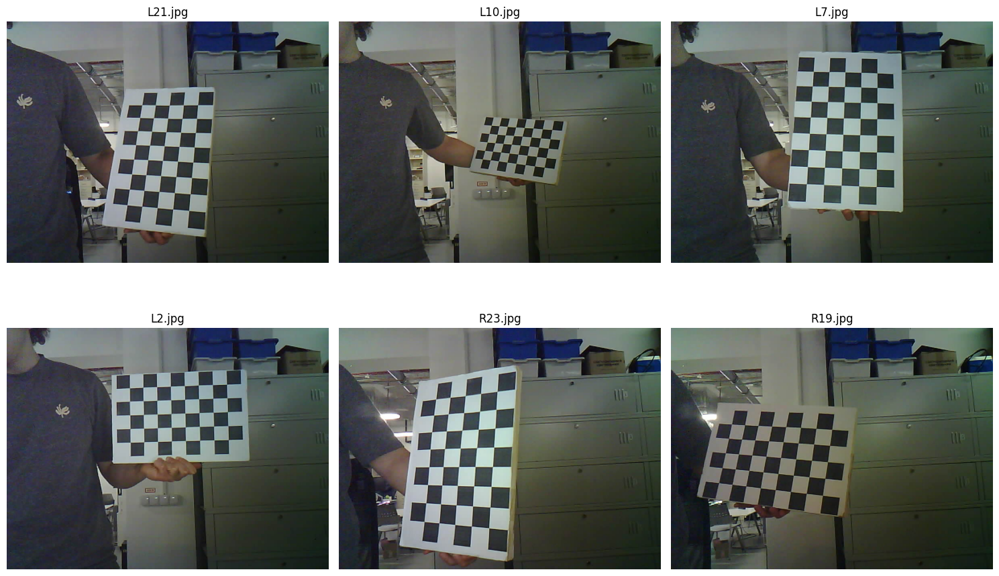

In [3]:
import os
import cv2
import random
import matplotlib.pyplot as plt

CHECKERBOARD_PATH = "/content/dataset/Dataset/checkerBoardDataset"
def get_image_paths(folder_path, extensions=(".jpg", ".jpeg", ".png")):
    image_paths = []
    for root, _, files in os.walk(folder_path):
        for f in files:
            if f.lower().endswith(extensions):
                image_paths.append(os.path.join(root, f))
    return sorted(image_paths)

def show_images(image_paths, num_images=5, cols=3):
    if not image_paths:
        print("No images found in the folder.")
        return

    num_images = min(num_images, len(image_paths))
    selected = random.sample(image_paths, num_images)
    rows = (num_images + cols - 1) // cols
    plt.figure(figsize=(15, 5 * rows))
    for i, img_path in enumerate(selected):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.title(os.path.basename(img_path))
        plt.axis("off")

    plt.tight_layout()
    plt.show()

image_paths = get_image_paths(CHECKERBOARD_PATH)
show_images(image_paths, num_images=6, cols=3)

### Task 2: Detect Checkerboard Corners (5%)

In [4]:

# TODO: Detect checkerboard corners in all image pairs.
# Hint: use cv2.findChessboardCorners(gray, (cols, rows))
# and cv2.cornerSubPix() to refine corner accuracy.

# Example variables:
# CHECKERBOARD = (9,6)
# objpoints = []  # 3D points
# imgpoints_left, imgpoints_right = [], []  # 2D image points for each camera

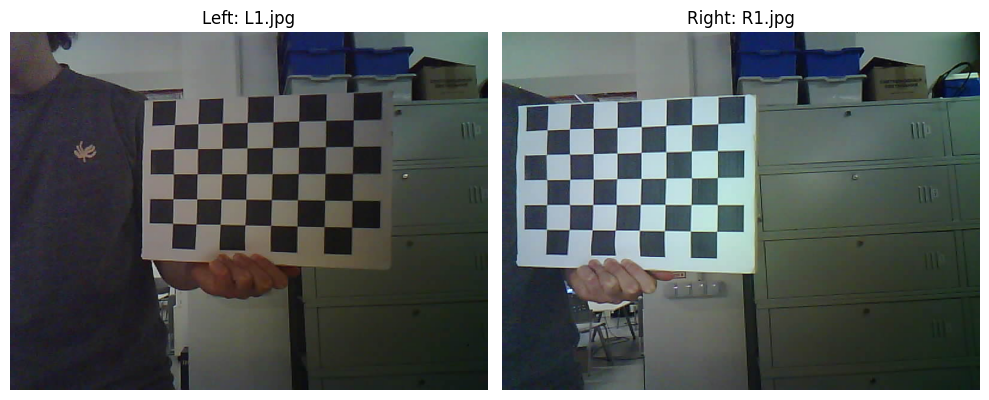

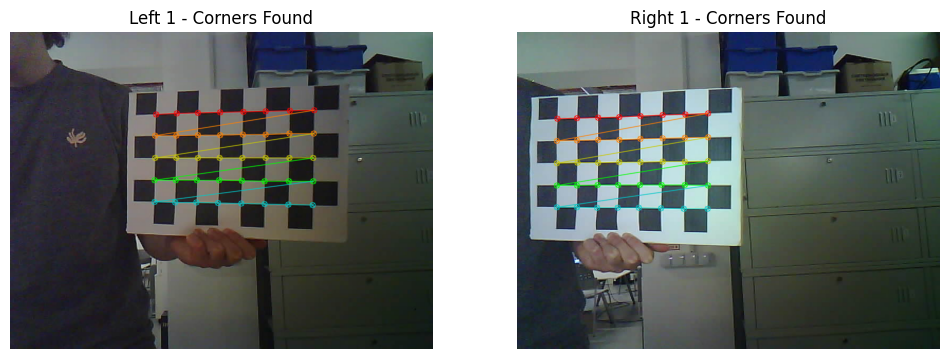

Pair 1: Corners found in both images


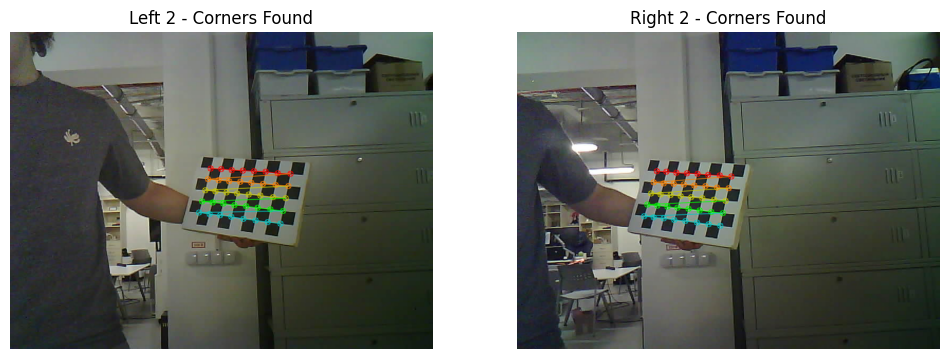

Pair 2: Corners found in both images


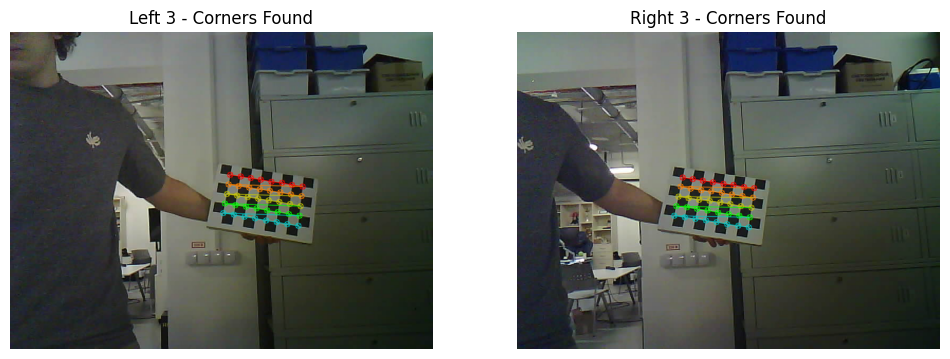

Pair 3: Corners found in both images


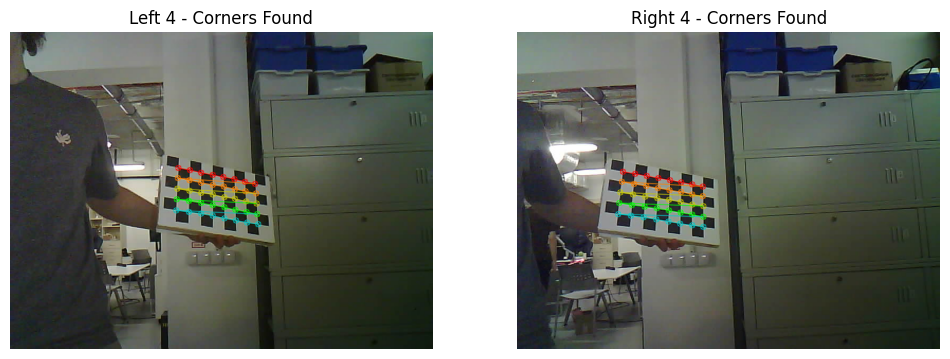

Pair 4: Corners found in both images


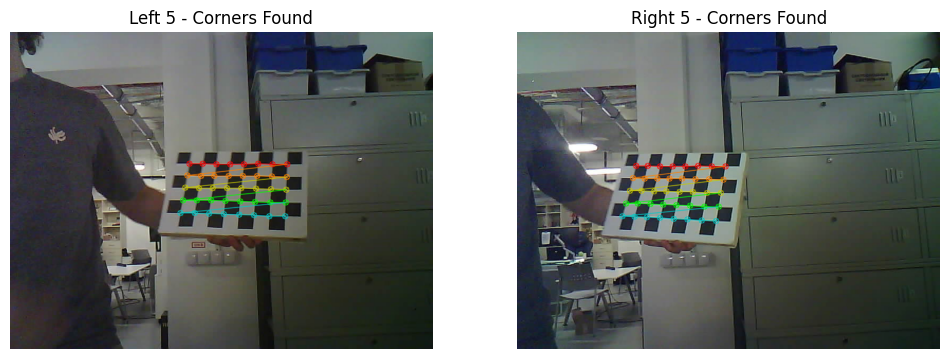

Pair 5: Corners found in both images


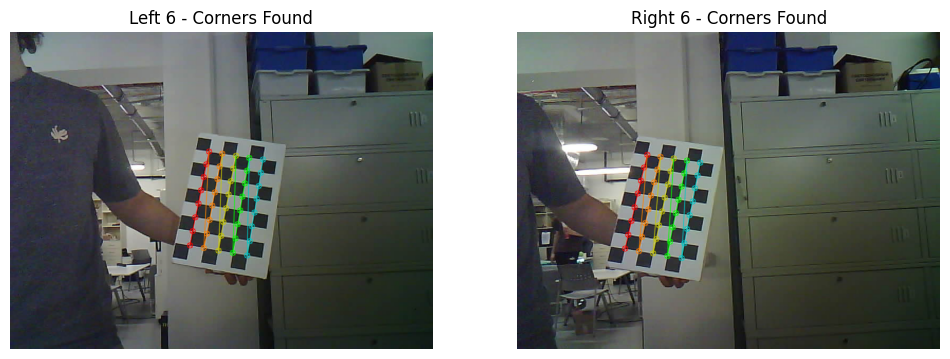

Pair 6: Corners found in both images


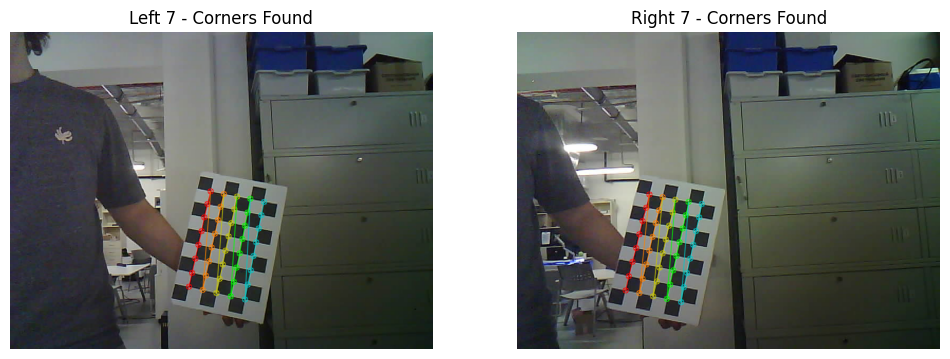

Pair 7: Corners found in both images


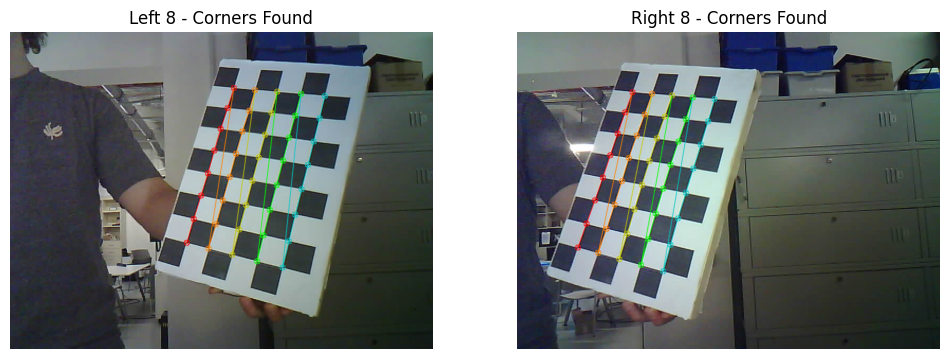

Pair 8: Corners found in both images


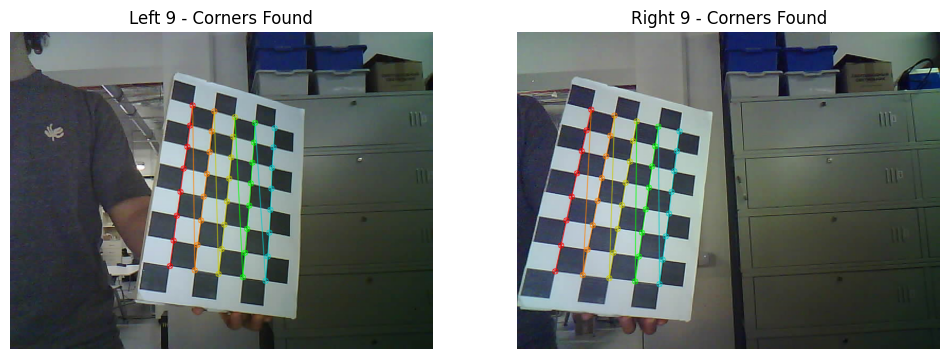

Pair 9: Corners found in both images


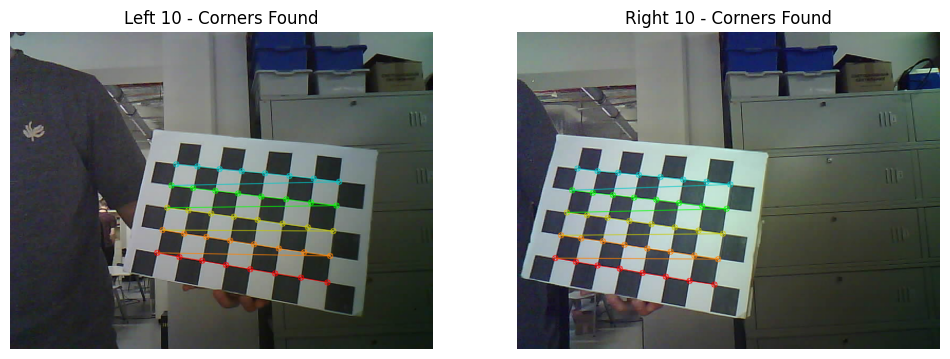

Pair 10: Corners found in both images


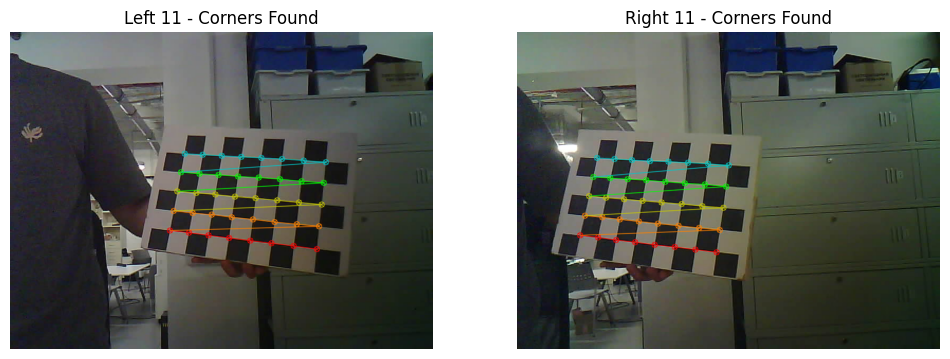

Pair 11: Corners found in both images


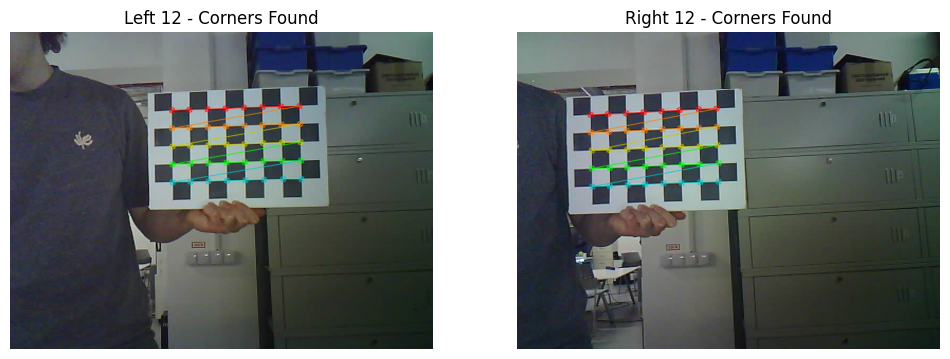

Pair 12: Corners found in both images


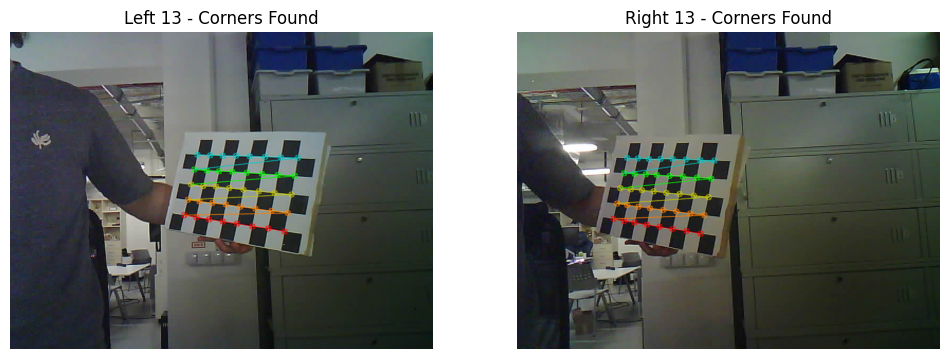

Pair 13: Corners found in both images


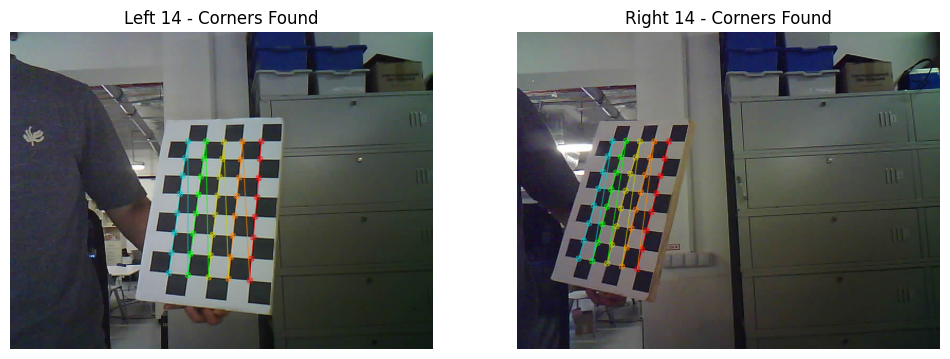

Pair 14: Corners found in both images


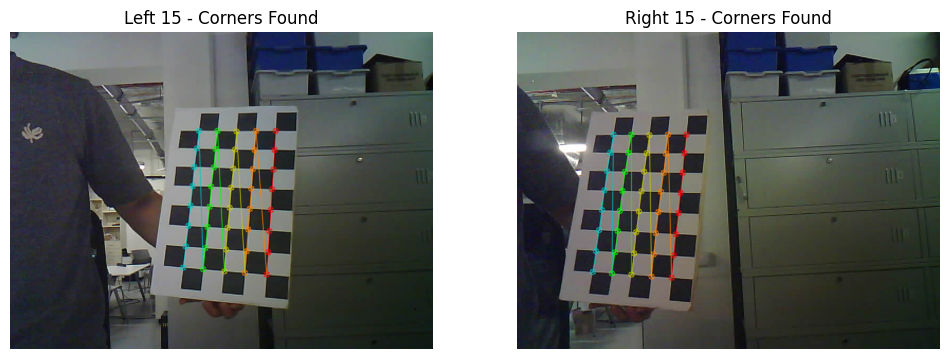

Pair 15: Corners found in both images


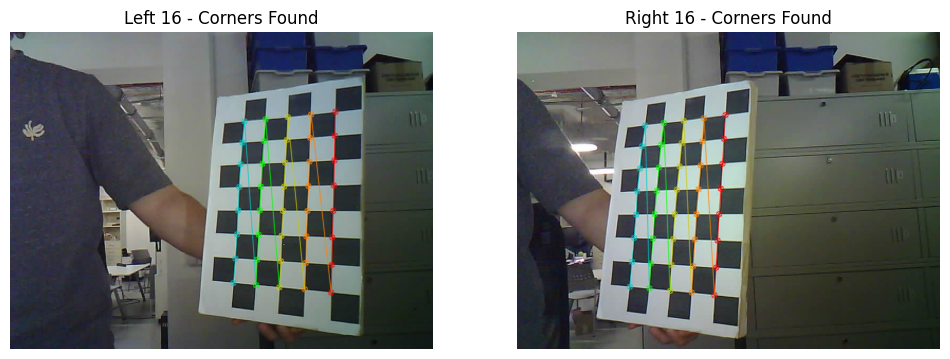

Pair 16: Corners found in both images


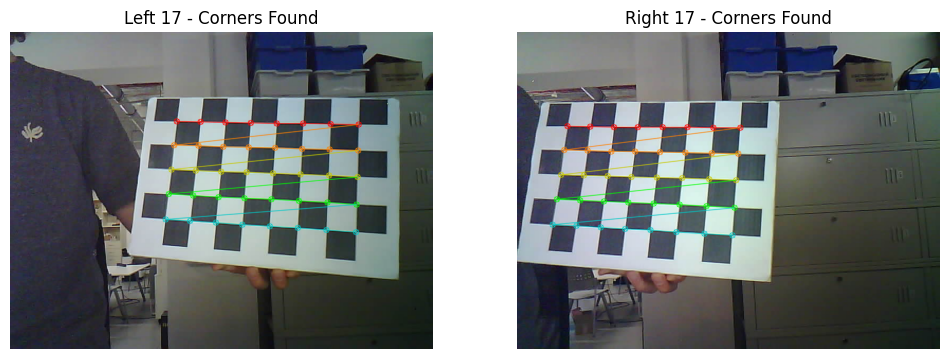

Pair 17: Corners found in both images


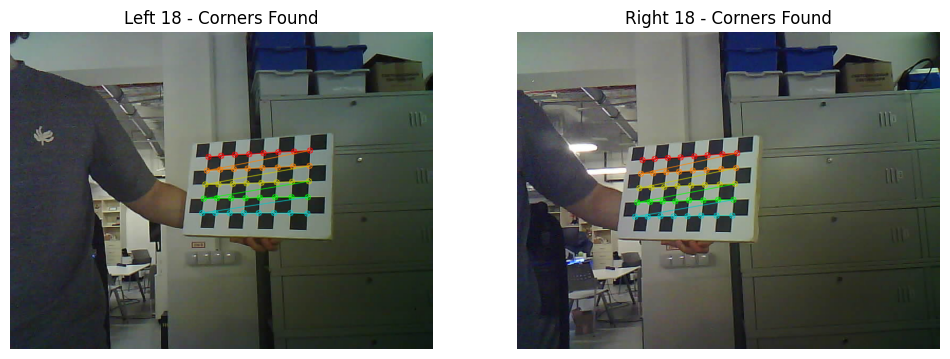

Pair 18: Corners found in both images


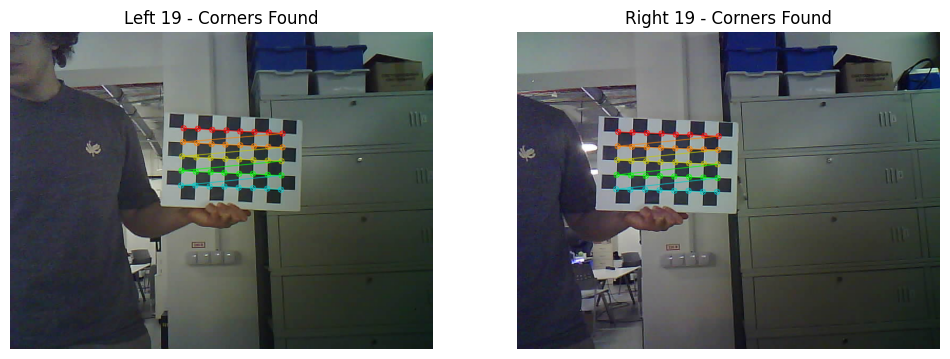

Pair 19: Corners found in both images


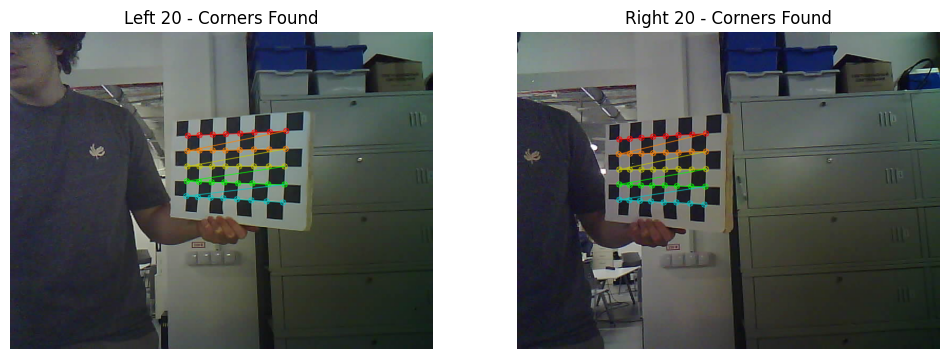

Pair 20: Corners found in both images


In [5]:
from glob import glob
import numpy as np

# Stereo Calibration Parameters
CHECKERBOARD = (8, 5)  # Inner corners (columns-1, rows-1)
square_size = 25  # Size of one square in the checkerboard in millimeters
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
# Criteria for corner refinement
# In stereoCalibrate, we use flags=cv2.CALIB_FIX_INTRINSIC because we already calibrated each camera individually

# Object points
objp = np.zeros((CHECKERBOARD[0] * CHECKERBOARD[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:CHECKERBOARD[0], 0:CHECKERBOARD[1]].T.reshape(-1, 2)
objp *= square_size

objpoints = []  # 3d points in real world space
imgpoints_left = []  # 2d points in left image plane
imgpoints_right = []  # 2d points in right image plane

def detect_corners_stereo(left_images, right_images, display_corners=True):
    left_corners = []
    right_corners = []
    valid_pairs = []

    for i, (left_img_path, right_img_path) in enumerate(zip(left_images, right_images)):
        img_left = cv2.imread(left_img_path)
        img_right = cv2.imread(right_img_path)
        gray_left = cv2.cvtColor(img_left, cv2.COLOR_BGR2GRAY)
        gray_right = cv2.cvtColor(img_right, cv2.COLOR_BGR2GRAY)

        # Find chessboard corners
        ret_left, corners_left = cv2.findChessboardCorners(gray_left, CHECKERBOARD, None)
        ret_right, corners_right = cv2.findChessboardCorners(gray_right, CHECKERBOARD, None)
        if ret_left and ret_right:
            # Refine corner positions
            corners_left_refined = cv2.cornerSubPix(gray_left, corners_left, (11, 11), (-1, -1), criteria)
            corners_right_refined = cv2.cornerSubPix(gray_right, corners_right, (11, 11), (-1, -1), criteria)
            left_corners.append(corners_left_refined)
            right_corners.append(corners_right_refined)
            valid_pairs.append(i)

            # Display images with corners
            if display_corners:
                img_left_corners = cv2.drawChessboardCorners(img_left.copy(), CHECKERBOARD, corners_left_refined, ret_left)
                img_right_corners = cv2.drawChessboardCorners(img_right.copy(), CHECKERBOARD, corners_right_refined, ret_right)
                plt.figure(figsize=(12, 5))
                plt.subplot(1, 2, 1)
                plt.imshow(cv2.cvtColor(img_left_corners, cv2.COLOR_BGR2RGB))
                plt.title(f'Left {i+1} - Corners Found')
                plt.axis('off')
                plt.subplot(1, 2, 2)
                plt.imshow(cv2.cvtColor(img_right_corners, cv2.COLOR_BGR2RGB))
                plt.title(f'Right {i+1} - Corners Found')
                plt.axis('off')
                plt.show()
            print(f"Pair {i+1}: Corners found in both images")
        else:
            print(f"Pair {i+1}: Failed to find corners in one or both images")
    return left_corners, right_corners, valid_pairs

def show_stereo_pair(left_path, right_path):
    left = cv2.imread(left_path)
    right = cv2.imread(right_path)
    left = cv2.cvtColor(left, cv2.COLOR_BGR2RGB)
    right = cv2.cvtColor(right, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(left)
    plt.title(f"Left: {left_path.split('/')[-1]}")
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.imshow(right)
    plt.title(f"Right: {right_path.split('/')[-1]}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# Load images
left_images = sorted(glob("/content/dataset/Dataset/checkerBoardDataset/L*.jpg"))
right_images = sorted(glob("/content/dataset/Dataset/checkerBoardDataset/R*.jpg"))

# Use first 20 images for calibration
left_images_calib = left_images[:20]
right_images_calib = right_images[:20]

# Use remaining pairs for testing
left_images_test = left_images[20:]
right_images_test = right_images[20:]

# Show the first pair
show_stereo_pair(left_images[0], right_images[0])

# Detect corners
left_corners, right_corners, valid_pairs = detect_corners_stereo(left_images_calib, right_images_calib, display_corners=True)

# Prepare object points for valid pairs
objpoints = [objp] * len(valid_pairs)

### Task 3: Calibrate Each Camera (5%)

In [6]:
# TODO: Calibrate each camera using cv2.calibrateCamera()
# Inputs: objpoints, imgpoints_left/right, image_size
# Outputs: cameraMatrix, distCoeffs, rvecs, tvecs

In [7]:
def calibrate_individual_cameras(objpoints, imgpoints_left, imgpoints_right, image_size):
    ret_left, mtx_left, dist_left, rvecs_left, tvecs_left = cv2.calibrateCamera(
        objpoints, imgpoints_left, image_size, None, None)
    ret_right, mtx_right, dist_right, rvecs_right, tvecs_right = cv2.calibrateCamera(
        objpoints, imgpoints_right, image_size, None, None)
    return (mtx_left, dist_left, mtx_right, dist_right)



# Get image size
img_size = cv2.imread(left_images[0]).shape[1::-1]

# Calibrate individual cameras
mtx_left, dist_left, mtx_right, dist_right = calibrate_individual_cameras(
    objpoints, left_corners, right_corners, img_size)

print("Left camera matrix:")
print(mtx_left)
print("Right camera matrix:")
print(mtx_right)

# mtx_left, dist_left Left camera matrix & distortion coefficients
# mtx_right, dist_right Right camera matrix & distortion coefficients

# [[fx   0   cx]    fx: Focal length in x-direction (pixels)
#  [ 0   fy  cy]    fy: Focal length in y-direction (pixels)
#  [ 0    0   1]]   cx: Principal point x-coordinate (optical center x)
#                   cy: Principal point y-coordinate (optical center y)


Left camera matrix:
[[758.3545071    0.         410.8775556 ]
 [  0.         753.56080542 300.31606922]
 [  0.           0.           1.        ]]
Right camera matrix:
[[753.76812776   0.         413.93271043]
 [  0.         745.23116391 318.87942007]
 [  0.           0.           1.        ]]


### Task 4: Stereo Calibration (5%)

In [8]:

# TODO: Perform stereo calibration using cv2.stereoCalibrate()
# Hint: pass both cameras’ intrinsics and distortion coefficients
# Outputs: R, T, E, F (rotation, translation, essential, and fundamental matrices)

In [9]:
# Perform stereo calibration
retval, cameraMatrix1, distCoeffs1, cameraMatrix2, distCoeffs2, R, T, E, F = cv2.stereoCalibrate(
    objpoints, left_corners, right_corners,
    mtx_left, dist_left, mtx_right, dist_right,
    img_size, flags=cv2.CALIB_FIX_INTRINSIC)

print("Rotation matrix R:")
print(R)
print("Translation vector T:")
print(T)

# Camera extrinsic parameters
# R, T Rotation matrix and Translation vector between cameras

Rotation matrix R:
[[ 9.99568551e-01 -2.71007100e-04 -2.93707230e-02]
 [-3.18096812e-04  9.99798908e-01 -2.00509933e-02]
 [ 2.93702508e-02  2.00516851e-02  9.99367459e-01]]
Translation vector T:
[[-106.76270207]
 [   1.34831457]
 [  -9.51711816]]


###  Task 5: Rectification and Map Creationv (5%)

In [10]:

# TODO: Compute rectification transforms using cv2.stereoRectify()
# and cv2.initUndistortRectifyMap()
# Save rectification maps for later use.

In [11]:
# Stereo rectification parameters
# R1, R2: 3x3 rectification transforms - rotate original camera views to make image planes coplanar
#          (Applied to left and right cameras respectively to align epipolar lines)

# P1, P2: 3x4 projection matrices - define camera coordinates in the rectified stereo system
#         P1 typically keeps left camera as reference, P2 incorporates baseline for right camera

# Q: 4x4 disparity-to-depth mapping matrix - converts disparity (pixel difference) to 3D coordinates
#    Used in reprojectImageTo3D() to compute real-world XYZ coordinates from stereo disparity

# roi1, roi2: (x, y, width, height) tuples defining valid regions in rectified images
#             After rectification, some border areas may be invalid/black - these ROIs indicate usable pixels


R1, R2, P1, P2, Q, roi1, roi2 = cv2.stereoRectify(
    cameraMatrix1, distCoeffs1,  # Left camera intrinsics & distortion
    cameraMatrix2, distCoeffs2,  # Right camera intrinsics & distortion
    img_size,                    # Image dimensions (width, height)
    R, T,                        # Relative rotation & translation between cameras
    alpha=1)                     # Scaling (0=crop, 1=keep all pixels)

# Create rectification maps for left camera
left_map_x, left_map_y = cv2.initUndistortRectifyMap(
    cameraMatrix1, distCoeffs1,  # Left camera parameters
    R1, P1,                      # Rectification transform & new projection matrix
    img_size,                    # Output image size
    cv2.CV_32FC1)                # Output map data type (32-bit float)

# Create rectification maps for right camera
right_map_x, right_map_y = cv2.initUndistortRectifyMap(
    cameraMatrix2, distCoeffs2,  # Right camera parameters
    R2, P2,                      # Rectification transform & new projection matrix
    img_size,                    # Output image size
    cv2.CV_32FC1)                # Output map data type (32-bit float)

# Save calibration parameters
calibration_data = {
    'cameraMatrix1': cameraMatrix1,
    'distCoeffs1': distCoeffs1,
    'cameraMatrix2': cameraMatrix2,
    'distCoeffs2': distCoeffs2,
    'R': R,
    'T': T,
    'E': E,
    'F': F,
    'R1': R1,
    'R2': R2,
    'P1': P1,
    'P2': P2,
    'Q': Q,
    'left_map_x': left_map_x,
    'left_map_y': left_map_y,
    'right_map_x': right_map_x,
    'right_map_y': right_map_y
}
np.save('stereo_calibration.npy', calibration_data)
print("Calibration data saved to stereo_calibration.npy")

Calibration data saved to stereo_calibration.npy


## Part II — Depth Map Computation (15%)

In [12]:

# TODO: Load a pair of rectified stereo images (left, right)

# Convert to grayscale
# grayL = cv2.cvtColor(left_img, cv2.COLOR_BGR2GRAY)
# grayR = cv2.cvtColor(right_img, cv2.COLOR_BGR2GRAY)


In [13]:

# TODO: Compute disparity map
# Hint: use cv2.StereoBM_create() or cv2.StereoSGBM_create()

# Visualize using matplotlib
# plt.imshow(disparity, cmap='plasma')


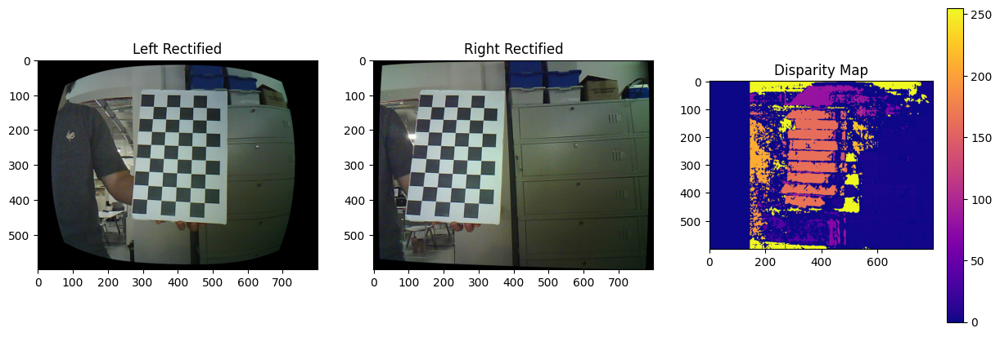

In [14]:
def compute_disparity_map(left_img, right_img):
    """
    Compute disparity map from rectified stereo images
    """
    # Convert to grayscale
    gray_left = cv2.cvtColor(left_img, cv2.COLOR_BGR2GRAY)
    gray_right = cv2.cvtColor(right_img, cv2.COLOR_BGR2GRAY)

    # Create stereo matcher
    # stereoBM
    #stereo = cv2.StereoBM_create(numDisparities=80, blockSize=15)

    # StereoSGBM
    stereo = cv2.StereoSGBM_create(
         minDisparity=0,
         numDisparities=144, # Maximum disparity minus minimum disparity, must be divisible by 16
         blockSize=5, # Matched block size
         P1=8*3*5**2, # The first parameter controlling the disparity smoothness (usually 8*number_of_image_channels*blockSize**2)
         P2=32*3*5**2, # The second parameter controlling the disparity smoothness (usually 32*number_of_image_channels*blockSize**2)
         disp12MaxDiff=1, # Maximum allowed difference in the left-right disparity check
         uniquenessRatio=15, # Margin in percentage by which the best computed disparity should be better than the second best
         speckleWindowSize=0, # Maximum size of smooth disparity regions to consider their noise speckles and invalidate
         speckleRange=2 # Maximum disparity variation within each connected component
     )

    # Compute disparity
    disparity = stereo.compute(gray_left, gray_right)
    # Normalize for visualization
    disparity_vis = cv2.normalize(disparity, None, 0, 255, cv2.NORM_MINMAX)
    disparity_vis = np.uint8(disparity_vis)
    return disparity, disparity_vis

#print(len(left_images_test))
# Load test stereo pair
left_imag_t = cv2.imread(left_images_test[2])
right_imag_t = cv2.imread(right_images_test[2])
# Rectify images
left_rectified = cv2.remap(left_imag_t, left_map_x, left_map_y, cv2.INTER_LINEAR)
right_rectified = cv2.remap(right_imag_t, right_map_x, right_map_y, cv2.INTER_LINEAR)
# Compute disparity
disparity, disparity_vis = compute_disparity_map(left_rectified, right_rectified)

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(left_rectified, cv2.COLOR_BGR2RGB))
plt.title('Left Rectified')
plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(right_rectified, cv2.COLOR_BGR2RGB))
plt.title('Right Rectified')
plt.subplot(1, 3, 3)
plt.imshow(disparity_vis, cmap='plasma')
plt.title('Disparity Map')
plt.colorbar()
plt.show()

## Part III — Human Detection (YOLO) (10%)

In [15]:

# TODO: Load YOLO model and perform human detection on left image.
# Filter detections by class label 'person'

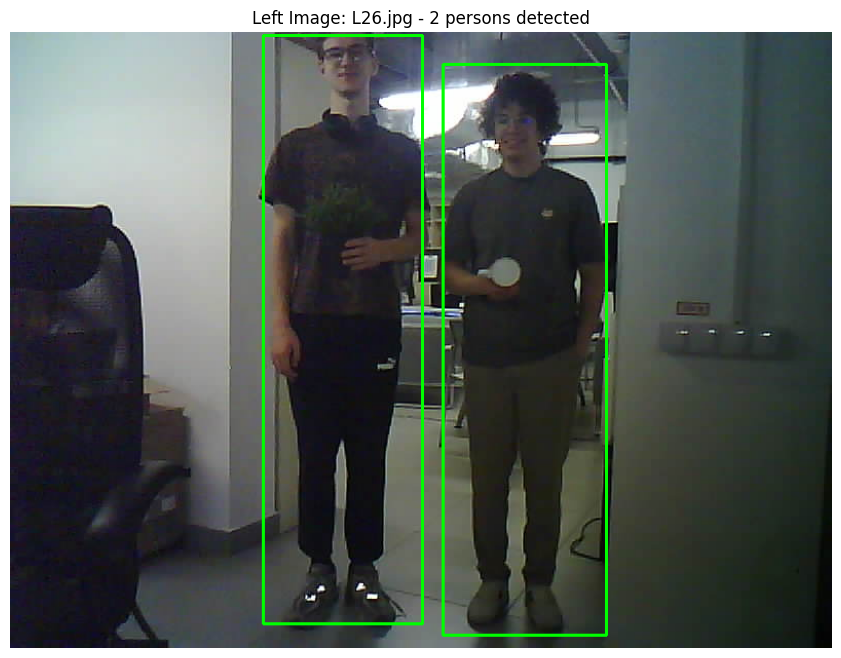

Detected 2 persons in left image


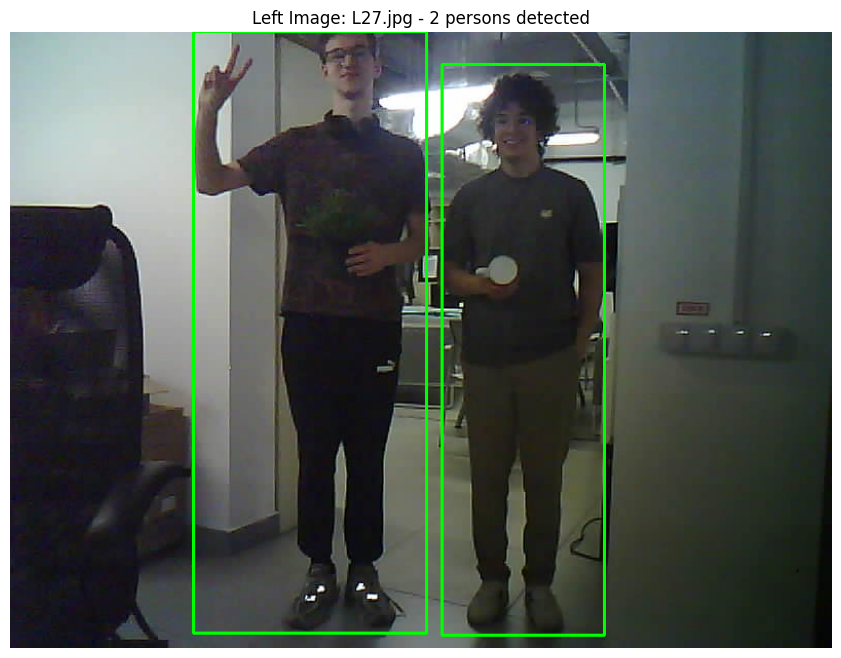

Detected 2 persons in left image


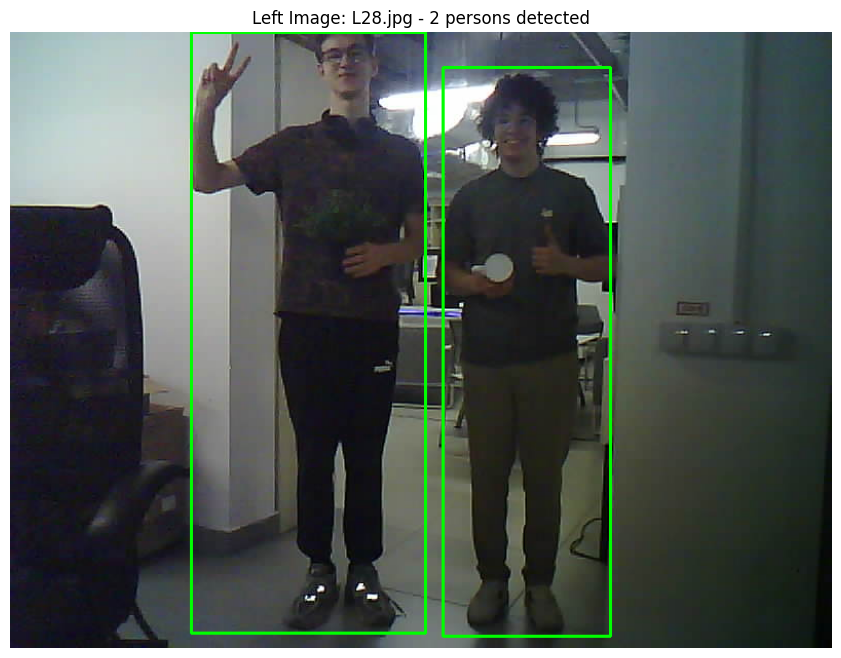

Detected 2 persons in left image


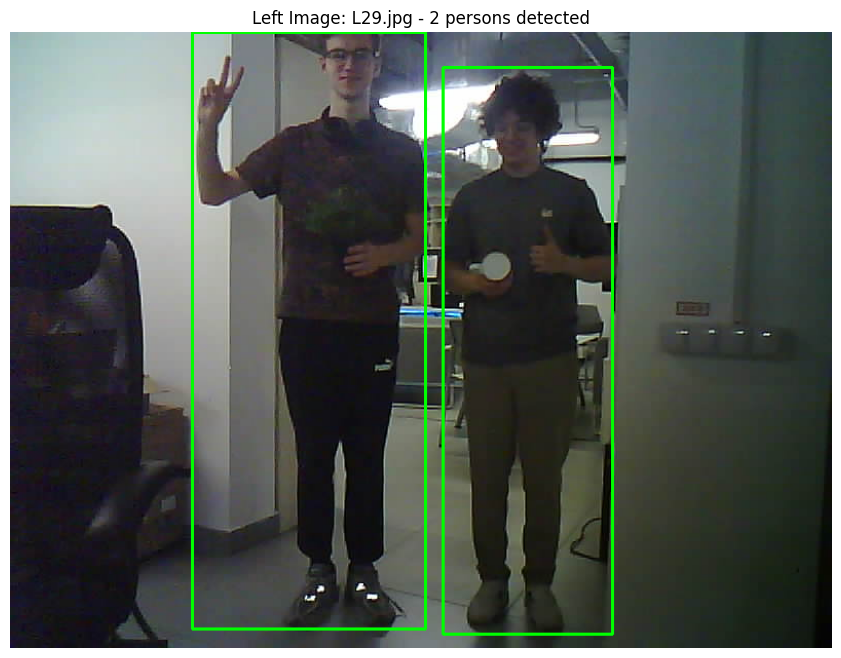

Detected 2 persons in left image


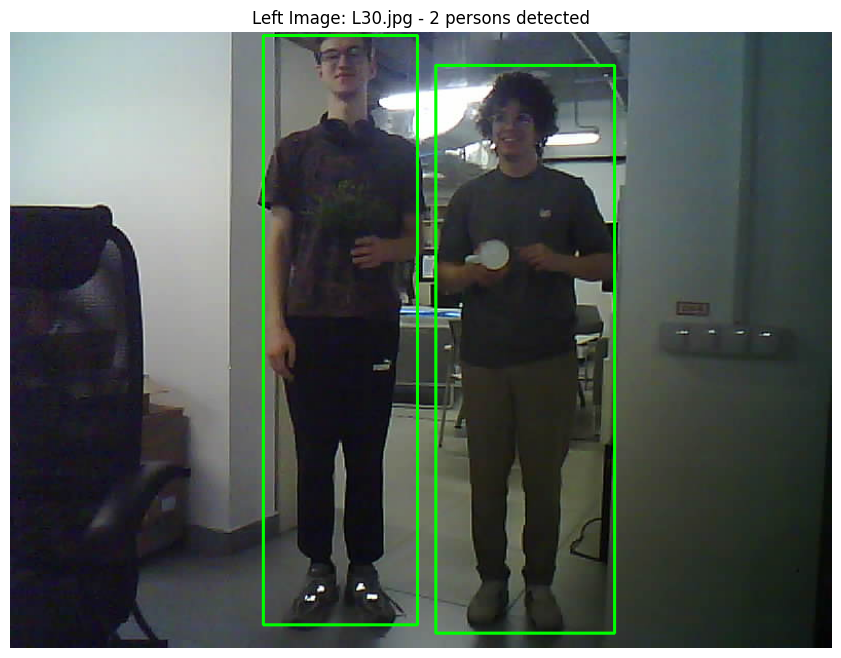

Detected 2 persons in left image


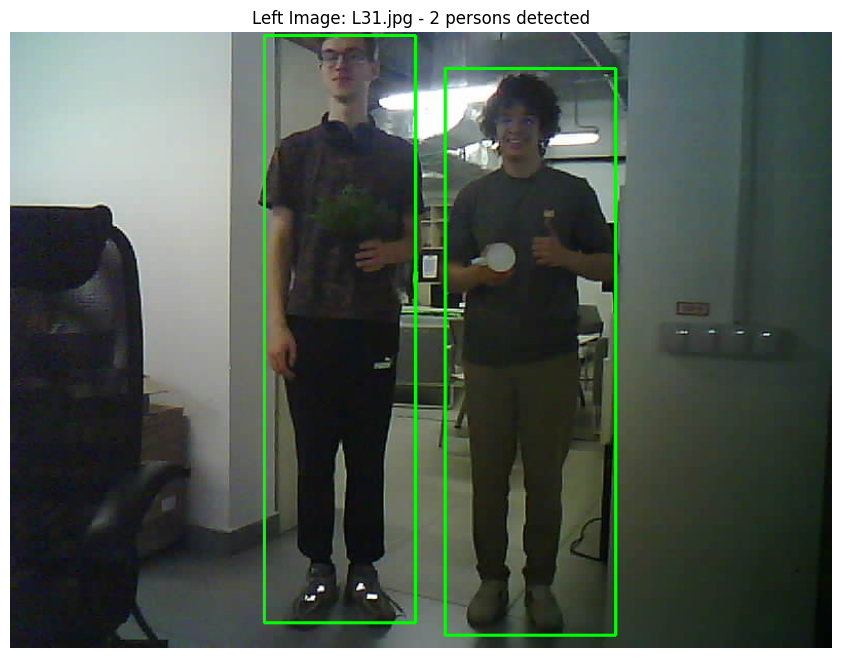

Detected 2 persons in left image


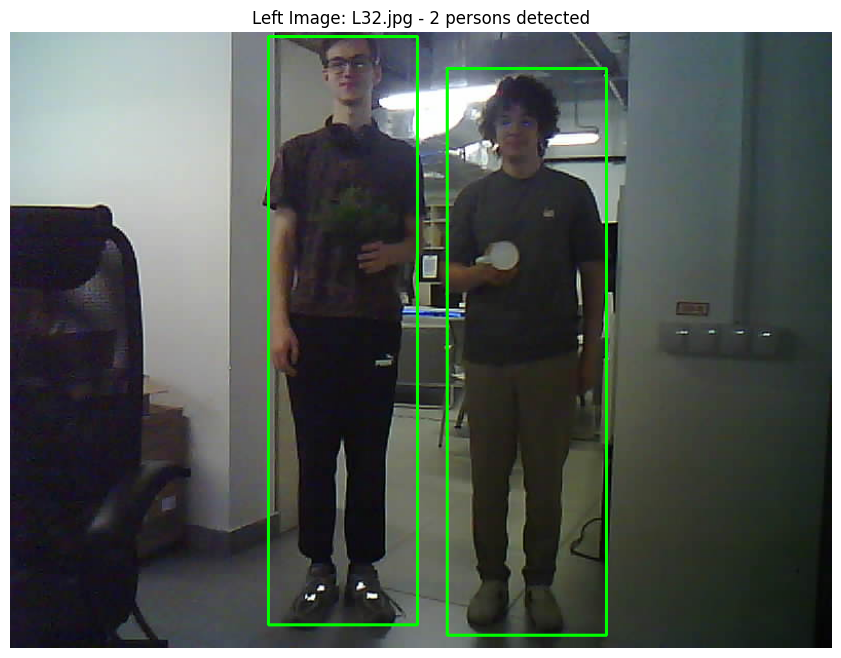

Detected 2 persons in left image


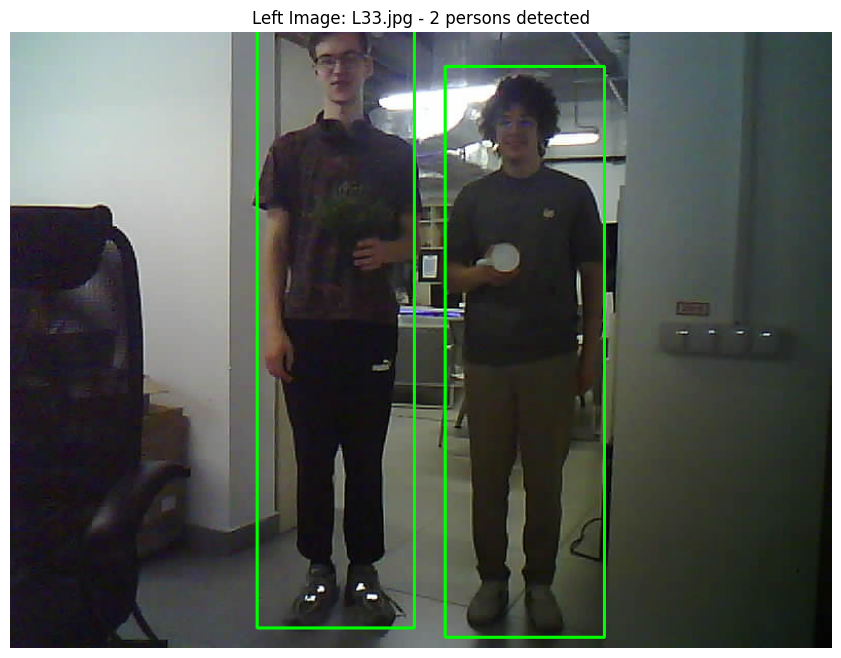

Detected 2 persons in left image


In [16]:
import urllib.request

# Confidence threshold for object detection conf_threshold = 0.5
# Non-maximum suppression threshold nms_threshold = 0.4

def setup_yolo():
    """
    Download YOLO model files
    - yolov4.weights: Pre-trained model weights
    - yolov4.cfg: Model architecture configuration
    - coco.names: List of 80 COCO dataset class names (person, car...)
    """
    files = {
        'yolov4.weights': 'https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights',
        'yolov4.cfg': 'https://raw.githubusercontent.com/AlexeyAB/darknet/master/cfg/yolov4.cfg',
        'coco.names': 'https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names'
    }
    for filename, url in files.items():
        if not os.path.exists(filename):
            print(f"Downloading {filename}...")
            urllib.request.urlretrieve(url, filename)

def load_yolo():
    """
    Load YOLO model and prepare for inference
    Returns: neural network, output layer names, and class names
    """

    # Load pre-trained YOLO model with weights and configuration
    net = cv2.dnn.readNetFromDarknet('yolov4.cfg', 'yolov4.weights')
    # Use OpenCV as backend and CPU for computation (change to DNN_TARGET_OPENCL for GPU)
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
    net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)
    # Get output layer names
    ln = net.getLayerNames()
    output_indices = net.getUnconnectedOutLayers()

    if isinstance(output_indices, np.ndarray):
        output_layers = [ln[i - 1] for i in output_indices.flatten()]
    else:
        output_layers = [ln[i[0] - 1] for i in output_indices]

    with open('coco.names', 'r') as f:
        classes = [line.strip() for line in f.readlines()]

    return net, output_layers, classes

def detect_humans_yolo(image, net, output_layers, classes):
    height, width = image.shape[:2]

    # Prepare input blob for neural network
    # - 1/255.0: Normalize pixel values from 0-255 to 0-1
    # - (416, 416): Input size YOLO expects
    # - swapRB=True: Convert BGR to RGB (OpenCV uses BGR, YOLO expects RGB)
    # - crop=False: Don't crop image, resize instead
    blob = cv2.dnn.blobFromImage(image, 1/255.0, (416, 416), swapRB=True, crop=False)
    net.setInput(blob)
    outputs = net.forward(output_layers)
    boxes = []
    confidences = []
    # Process detections from each output layer
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            # Filter for person class (class_id = 0)
            if class_id == 0 and confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                # Convert center coordinates to top-left corner coordinates
                x = int(center_x - w/2)
                y = int(center_y - h/2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))

    # Apply non-maximum suppression to remove overlapping boxes
    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    human_boxes = []
    if len(indices) > 0:
        for i in indices.flatten():
            human_boxes.append(boxes[i])

    return human_boxes

# Setup and load YOLO
setup_yolo()
net, output_layers, classes = load_yolo()

# Load left images from dataset
left_images_path = "/content/dataset/Dataset/personsDataset/L*.jpg"
left_image_paths = sorted(glob(left_images_path))

# Process all left images
for img_path in left_image_paths:
    # Load left image
    left_img = cv2.imread(img_path)
    # Detect humans
    human_boxes = detect_humans_yolo(left_img, net, output_layers, classes)
    # Draw bounding boxes
    img_with_boxes = left_img.copy()
    for box in human_boxes:
        x, y, w, h = box
        cv2.rectangle(img_with_boxes, (x, y), (x + w, y + h), (0, 255, 0), 2)
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
    plt.title(f'Left Image: {os.path.basename(img_path)} - {len(human_boxes)} persons detected')
    plt.axis('off')
    plt.show()

    print(f"Detected {len(human_boxes)} persons in left image")

## Part IV — Distance Estimation (20%)

In [17]:

# TODO: Compute distance to each detected person using disparity.
# Use Z = f * B / d, where:
# f: focal length (from calibration)
# B: baseline distance between cameras
# d: mean disparity within the bounding box of the person

# Example:
# distance = f * B / (mean_disparity + 1e-6)

# TODO: Compute distance to each detected person using disparity.
# Use Z = f * B / d, where:
# f: focal length (from calibration)
# B: baseline distance between cameras
# d: mean disparity within the bounding box of the person

Stereo pair 1/8
Person1: mean disparity= 39.71px, distance= 2.42m
Person2: mean disparity= 38.00px, distance= 2.53m


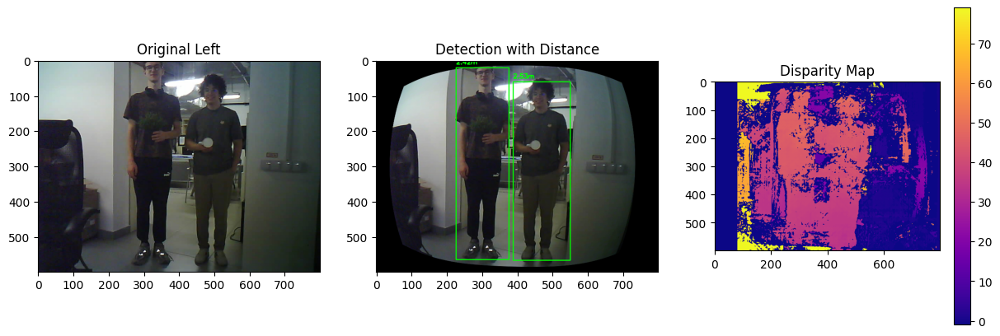

Person1: distance= 2.42m, disparity= 39.71px
Person2: distance= 2.53m, disparity= 38.00px
Stereo pair 2/8
Person1: mean disparity= 39.90px, distance= 2.41m
Person2: mean disparity= 38.21px, distance= 2.51m


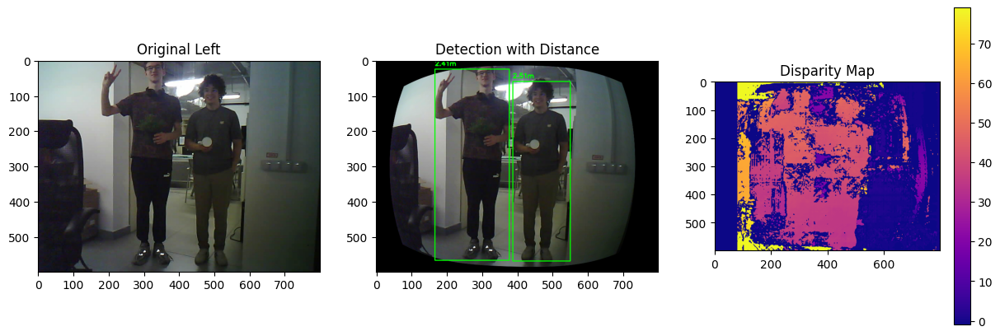

Person1: distance= 2.41m, disparity= 39.90px
Person2: distance= 2.51m, disparity= 38.21px
Stereo pair 3/8
Person1: mean disparity= 38.96px, distance= 2.46m
Person2: mean disparity= 36.63px, distance= 2.62m


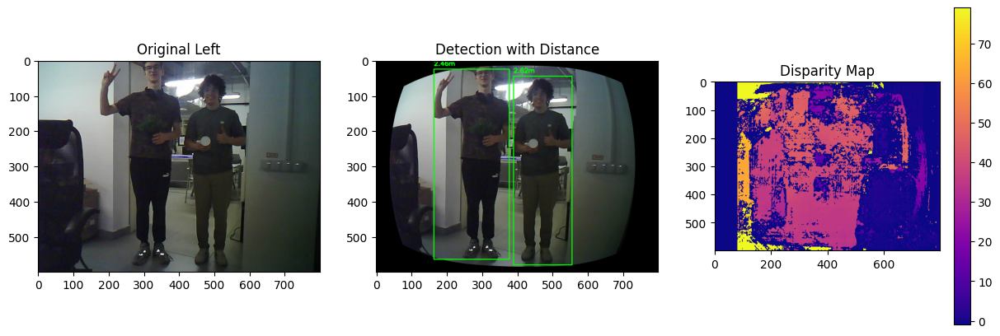

Person1: distance= 2.46m, disparity= 38.96px
Person2: distance= 2.62m, disparity= 36.63px
Stereo pair 4/8
Person1: mean disparity= 38.33px, distance= 2.50m
Person2: mean disparity= 37.67px, distance= 2.55m


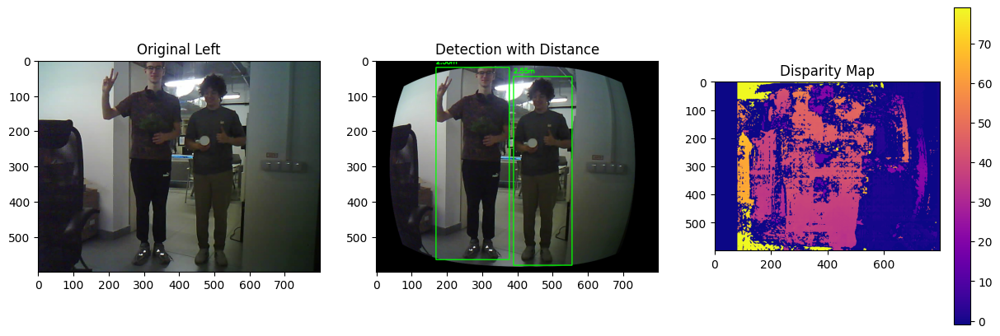

Person1: distance= 2.50m, disparity= 38.33px
Person2: distance= 2.55m, disparity= 37.67px
Stereo pair 5/8
Person1: mean disparity= 39.39px, distance= 2.44m
Person2: mean disparity= 34.63px, distance= 2.77m


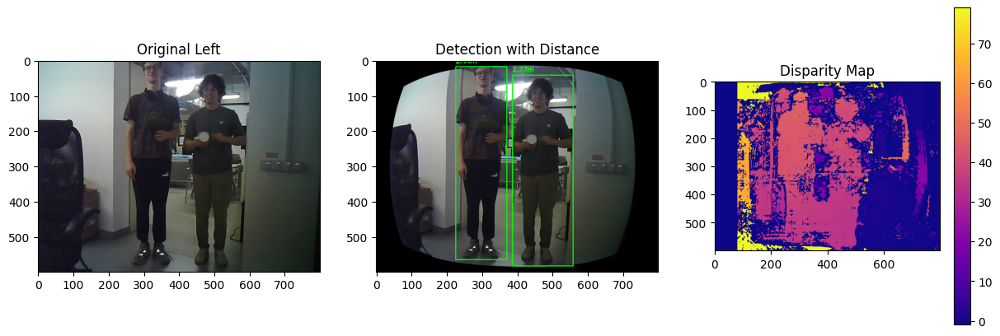

Person1: distance= 2.44m, disparity= 39.39px
Person2: distance= 2.77m, disparity= 34.63px
Stereo pair 6/8
Person1: mean disparity= 37.71px, distance= 2.55m
Person2: mean disparity= 36.73px, distance= 2.61m


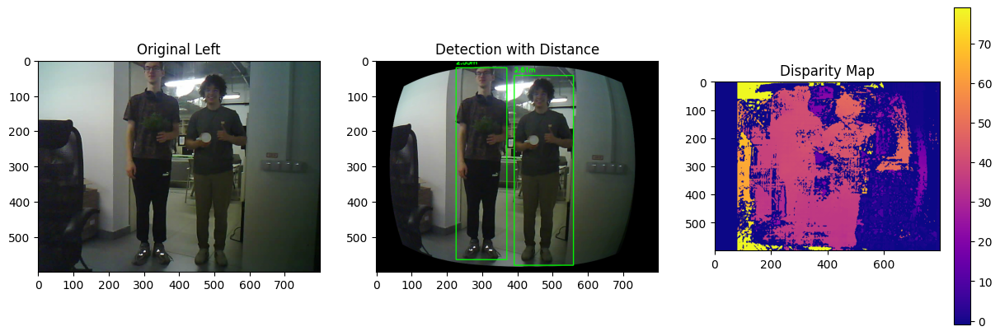

Person1: distance= 2.55m, disparity= 37.71px
Person2: distance= 2.61m, disparity= 36.73px
Stereo pair 7/8
Person1: mean disparity= 42.99px, distance= 2.23m
Person2: mean disparity= 37.94px, distance= 2.53m


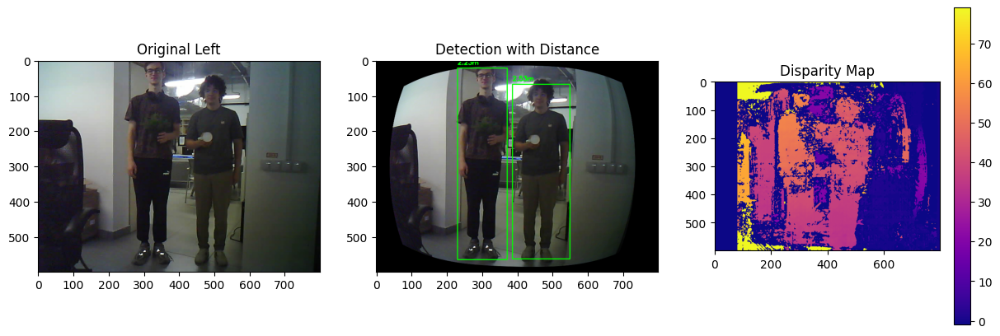

Person1: distance= 2.23m, disparity= 42.99px
Person2: distance= 2.53m, disparity= 37.94px


In [18]:
# results from all pairs were fairly accurate
def compute_person_distances(disparity_map, human_boxes):
    FOCAL_LENGTH = (mtx_left[0, 0] + mtx_right[0, 0]) / 2 # Mean of left and right camera focal lengths
    BASELINE = 0.127  # in meters, physical distance between cameras
    distances = []
    mean_disparities = []

    for i, box in enumerate(human_boxes):
        x, y, w, h = box
        # Extract disparity values within bounding box
        box_disparity = disparity_map[y:y+h, x:x+w]
        valid_disparities = box_disparity[box_disparity > 0]
        if len(valid_disparities) > 0:
            mean_disparity = np.mean(valid_disparities)
            mean_disparities.append(mean_disparity)
            # Compute distance using Z = f * B / d
            distance = (FOCAL_LENGTH * BASELINE) / (mean_disparity + 1e-6)
            distances.append(distance)
            print(f"Person{i+1}: mean disparity= {mean_disparity:.2f}px, distance= {distance:.2f}m")
        else:
            mean_disparities.append(0)
            distances.append(-1)
            print(f"Person{i+1}: No valid disparities found")
    return distances, mean_disparities

def detect_humans_with_distance(left_img, right_img, net, output_layers, classes):
    # Rectify stereo images
    left_rectified = cv2.remap(left_img, left_map_x, left_map_y, cv2.INTER_LINEAR)
    right_rectified = cv2.remap(right_img, right_map_x, right_map_y, cv2.INTER_LINEAR)
    # Compute disparity map
    gray_left = cv2.cvtColor(left_rectified, cv2.COLOR_BGR2GRAY)
    gray_right = cv2.cvtColor(right_rectified, cv2.COLOR_BGR2GRAY)

    stereo = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities=80,  # 80 showed best results
        blockSize=5,
        P1=8*3*5**2,
        P2=32*3*5**2,
        disp12MaxDiff=1,
        uniquenessRatio=15,
        speckleWindowSize=0,
        speckleRange=2
    )
    disparity = stereo.compute(gray_left, gray_right).astype(np.float32) / 16.0

    # Detect humans
    human_boxes = detect_humans_yolo(left_rectified, net, output_layers, classes)
    # Compute distances
    distances, mean_disparities = compute_person_distances(disparity, human_boxes)
    # Visualize results
    result_img = left_rectified.copy()
    for i, (box, distance, mean_disp) in enumerate(zip(human_boxes, distances, mean_disparities)):
        x, y, w, h = box
        if distance > 0:
            cv2.rectangle(result_img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            text = f'{distance:.2f}m'
            cv2.putText(result_img, text, (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        else:
            cv2.rectangle(result_img, (x, y), (x + w, y + h), (0, 0, 255), 2)
            cv2.putText(result_img, 'No disparity', (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
    return result_img, human_boxes, distances, mean_disparities, disparity

def run_stereo_analysis():
    """Run stereo distance estimation on all image pairs"""
    # Load YOLO model
    net, output_layers, classes = load_yolo()
    # Load stereo image pairs
    left_images = sorted(glob("/content/dataset/Dataset/personsDataset/L*.jpg"))
    right_images = sorted(glob("/content/dataset/Dataset/personsDataset/R*.jpg"))

    # Process each stereo pair
    for i, (left_path, right_path) in enumerate(zip(left_images, right_images)):
        print(f"Stereo pair {i+1}/{len(left_images)}")
        # Load images
        left_img = cv2.imread(left_path)
        right_img = cv2.imread(right_path)
        # Perform human detection with distance estimation
        result_img, human_boxes, distances, mean_disparities, disparity_map = detect_humans_with_distance(left_img, right_img, net, output_layers, classes)

        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(cv2.cvtColor(left_img, cv2.COLOR_BGR2RGB))
        plt.title('Original Left')
        plt.subplot(1, 3, 2)
        plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
        plt.title('Detection with Distance')
        plt.subplot(1, 3, 3)
        plt.imshow(disparity_map, cmap='plasma')
        plt.title('Disparity Map')
        plt.colorbar()
        plt.show()

        # Print results
        for j, (box, distance, mean_disp) in enumerate(zip(human_boxes, distances, mean_disparities)):
            if distance > 0:
                print(f"Person{j+1}: distance= {distance:.2f}m, disparity= {mean_disp:.2f}px")

run_stereo_analysis()

## Part V — Height Estimation via Known Object (Cup) (10%)

### Scenario
The scene must include **two people**, one of them holding a **cup** showing its **bottom circle**.  
The **diameter of the cup is known** (e.g., 0.07 m).

You will:
1. Detect the cup’s circular bottom with the **Hough Circle Transform**.  
2. Measure the circle’s apparent diameter in pixels.  
3. Compute the pixel-to-meter ratio.  
4. Use YOLO bounding boxes to measure a person’s pixel height.  
5. Estimate real height in meters.


In [19]:

# TODO: Detect the circular bottom of the cup
# Hint: use cv2.HoughCircles()

# cup_diameter_m = 0.07  # known cup diameter in meters
# cup_diameter_px = measured_circle_diameter_in_pixels


In [20]:

# TODO: Estimate the height of another person using YOLO bounding box height (in pixels)

# print(f"Estimated person height: {person_height_m:.2f} m")


Solution with rectification: best results for stereo pairs 2 & 7

Stereo pair 1/8
Cup detected: diameter = 28.0 px
Pixel-to-meter ratio: 0.003179 m/px
Person 1: pixel height = 544 px, estimated height = 1.73 m
Person 2: pixel height = 506 px, estimated height = 1.61 m
Person 1: estimated height = 1.73 meters
Person 2: estimated height = 1.61 meters


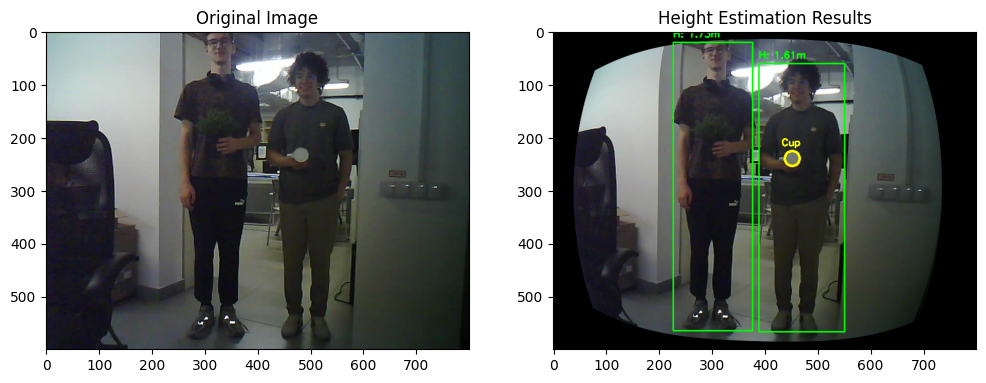

Stereo pair 2/8
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 542 px, estimated height = 1.86 m
Person 2: pixel height = 509 px, estimated height = 1.74 m
Person 1: estimated height = 1.86 meters
Person 2: estimated height = 1.74 meters


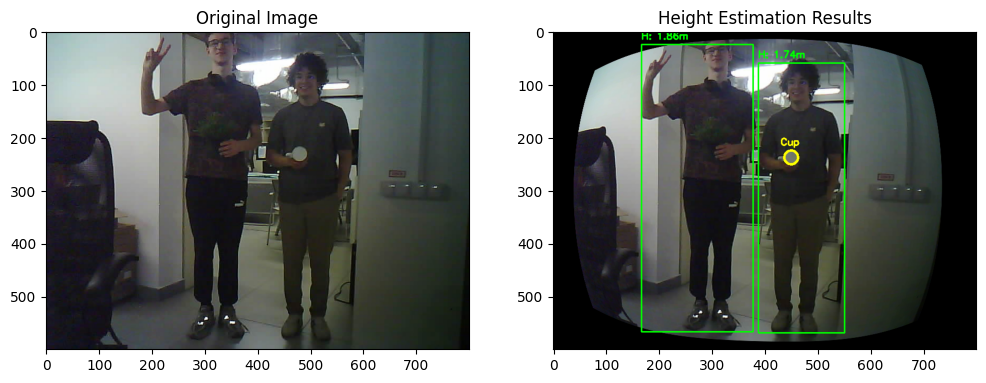

Stereo pair 3/8
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 539 px, estimated height = 1.85 m
Person 2: pixel height = 535 px, estimated height = 1.83 m
Person 1: estimated height = 1.85 meters
Person 2: estimated height = 1.83 meters


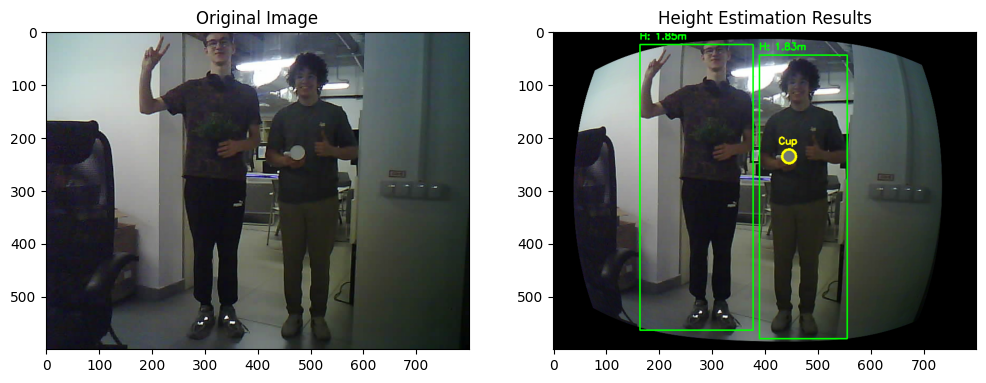

Stereo pair 4/8
Cup detected: diameter = 24.0 px
Pixel-to-meter ratio: 0.003708 m/px
Person 1: pixel height = 545 px, estimated height = 2.02 m
Person 2: pixel height = 535 px, estimated height = 1.98 m
Person 1: estimated height = 2.02 meters
Person 2: estimated height = 1.98 meters


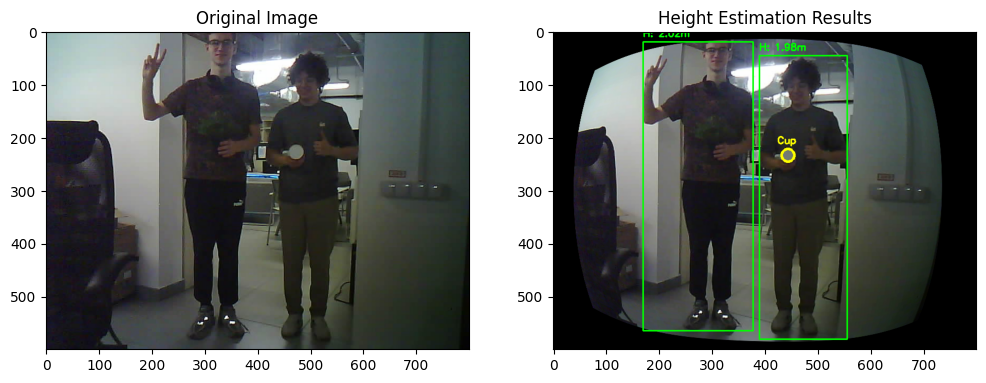

Stereo pair 5/8
Cup detected: diameter = 28.0 px
Pixel-to-meter ratio: 0.003179 m/px
Person 1: pixel height = 547 px, estimated height = 1.74 m
Person 2: pixel height = 541 px, estimated height = 1.72 m
Person 1: estimated height = 1.74 meters
Person 2: estimated height = 1.72 meters


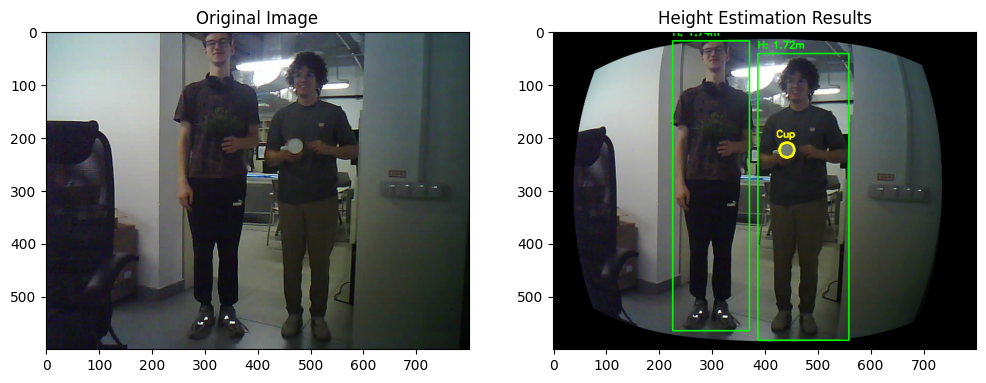

Stereo pair 6/8
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 544 px, estimated height = 1.86 m
Person 2: pixel height = 538 px, estimated height = 1.84 m
Person 1: estimated height = 1.86 meters
Person 2: estimated height = 1.84 meters


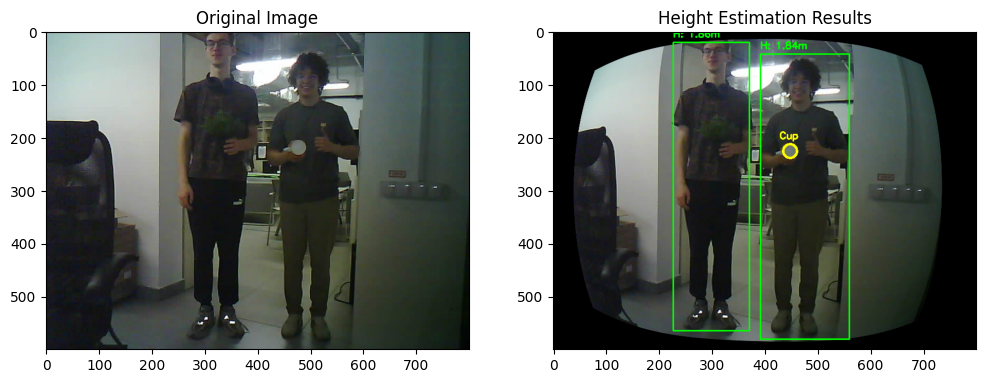

Stereo pair 7/8
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 543 px, estimated height = 1.86 m
Person 2: pixel height = 495 px, estimated height = 1.69 m
Person 1: estimated height = 1.86 meters
Person 2: estimated height = 1.69 meters


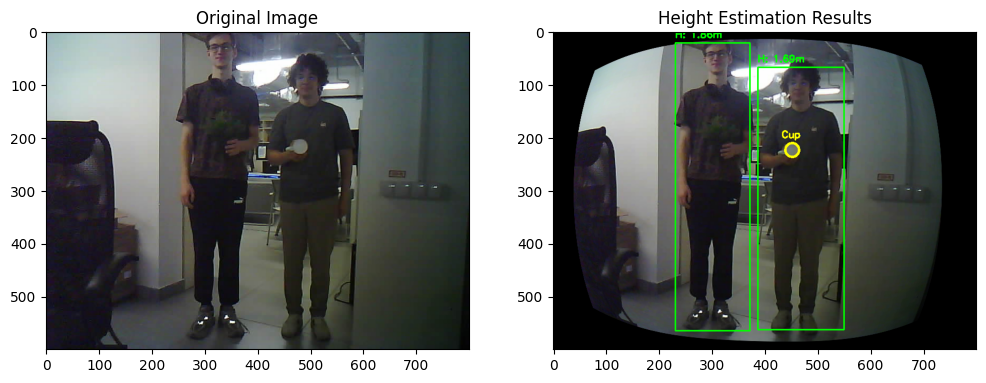

In [21]:
def detect_cup_circle(image):
    """Detect the circular bottom of a cup using Hough Circle Transform"""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (9, 9), 2)
    # Detect circles
    circles = cv2.HoughCircles(
        blurred,
        cv2.HOUGH_GRADIENT,
        dp=1,
        minDist=50,
        param1=50,
        param2=30,
        minRadius=10,
        maxRadius=50
    )

    if circles is not None:
        circles = np.round(circles[0, :]).astype("int")
        largest_circle = max(circles, key=lambda x: x[2])
        return largest_circle

    return None

def compute_height_using_cup_reference(left_img, human_boxes, cup_diameter_m=0.089):
    height_estimates = []
    # Detect cup circle
    cup_circle = detect_cup_circle(left_img)
    if cup_circle is None:
        print("No cup circle detected")
        return [-1] * len(human_boxes), None
    x_c, y_c, r_c = cup_circle
    cup_diameter_px = 2 * r_c
    # Calculate pixel-to-meter ratio
    pixel_to_meter_ratio = cup_diameter_m / cup_diameter_px
    print(f"Cup detected: diameter = {cup_diameter_px:.1f} px")
    print(f"Pixel-to-meter ratio: {pixel_to_meter_ratio:.6f} m/px")

    # Estimate height for each person
    for i, box in enumerate(human_boxes):
        x, y, w, h = box
        person_height_px = h
        person_height_m = person_height_px * pixel_to_meter_ratio
        height_estimates.append(person_height_m)
        print(f"Person {i+1}: pixel height = {person_height_px} px, estimated height = {person_height_m:.2f} m")

    return height_estimates, cup_circle

def run_complete_analysis():
    # Load YOLO model
    net, output_layers, classes = load_yolo()
    # Load stereo image pairs
    left_images = sorted(glob("/content/dataset/Dataset/personsDataset/L*.jpg"))
    right_images = sorted(glob("/content/dataset/Dataset/personsDataset/R*.jpg"))

    # Process each stereo pair
    for i, (left_path, right_path) in enumerate(zip(left_images, right_images)):
        print(f"Stereo pair {i+1}/{len(left_images)}")

        left_img = cv2.imread(left_path)
        right_img = cv2.imread(right_path)
        # Rectify images
        left_rectified = cv2.remap(left_img, left_map_x, left_map_y, cv2.INTER_LINEAR)
        # Detect humans
        human_boxes = detect_humans_yolo(left_rectified, net, output_layers, classes)
        # Compute heights using cup reference
        height_estimates, cup_circle = compute_height_using_cup_reference(left_rectified, human_boxes)
        # Results
        result_img = left_rectified.copy()

        # Draw cup circle if detected
        if cup_circle is not None:
            x_c, y_c, r_c = cup_circle
            cv2.circle(result_img, (x_c, y_c), r_c, (0, 255, 255), 3)
            cv2.putText(result_img, 'Cup', (x_c - 20, y_c - r_c - 10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 255), 2)

        # Draw person bounding boxes with height information
        for i, (box, height_est) in enumerate(zip(human_boxes, height_estimates)):
            x, y, w, h = box
            cv2.rectangle(result_img, (x, y), (x + w, y + h), (0, 255, 0), 2)

            height_text = f'H: {height_est:.2f}m' if height_est > 0 else 'H: N/A'
            cv2.putText(result_img, height_text, (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(left_img, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
        plt.title('Height Estimation Results')
        for j, (box, height_est) in enumerate(zip(human_boxes, height_estimates)):
            if height_est > 0:
                print(f"Person {j+1}: estimated height = {height_est:.2f} meters")
        plt.show()
run_complete_analysis()

Solution with no rectification: best accurate results for images 4 & 6

Processing image 1/8: L26.jpg
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 573 px, estimated height = 1.96 m
Person 2: pixel height = 556 px, estimated height = 1.90 m
Person 1:
  Position: (246, 3), Size: 155×573 px
  Estimated height: 1.96 meters

Person 2:
  Position: (421, 31), Size: 159×556 px
  Estimated height: 1.90 meters



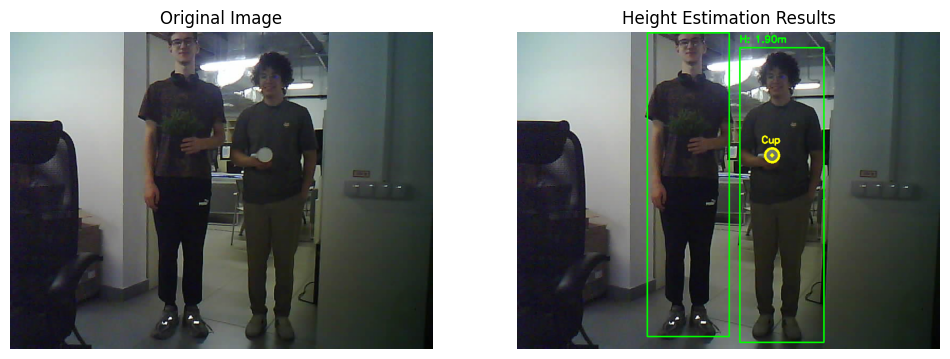

Processing image 2/8: L27.jpg
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 586 px, estimated height = 2.01 m
Person 2: pixel height = 556 px, estimated height = 1.90 m
Person 1:
  Position: (178, -1), Size: 227×586 px
  Estimated height: 2.01 meters

Person 2:
  Position: (420, 31), Size: 158×556 px
  Estimated height: 1.90 meters



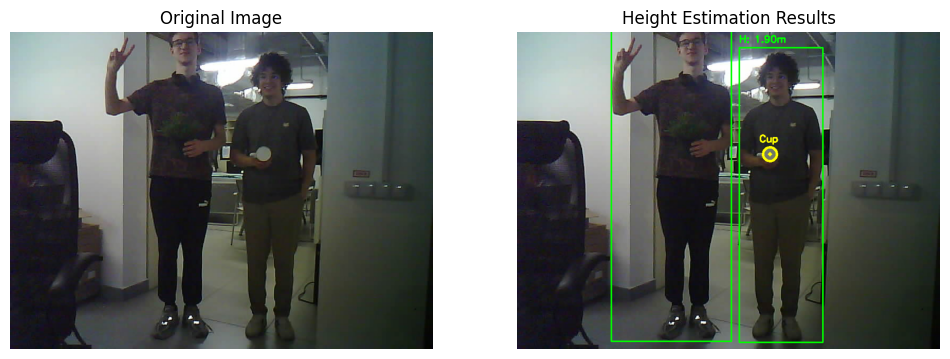

Processing image 3/8: L28.jpg
Cup detected: diameter = 26.0 px
Pixel-to-meter ratio: 0.003423 m/px
Person 1: pixel height = 585 px, estimated height = 2.00 m
Person 2: pixel height = 554 px, estimated height = 1.90 m
Person 1:
  Position: (176, 0), Size: 228×585 px
  Estimated height: 2.00 meters

Person 2:
  Position: (421, 34), Size: 163×554 px
  Estimated height: 1.90 meters



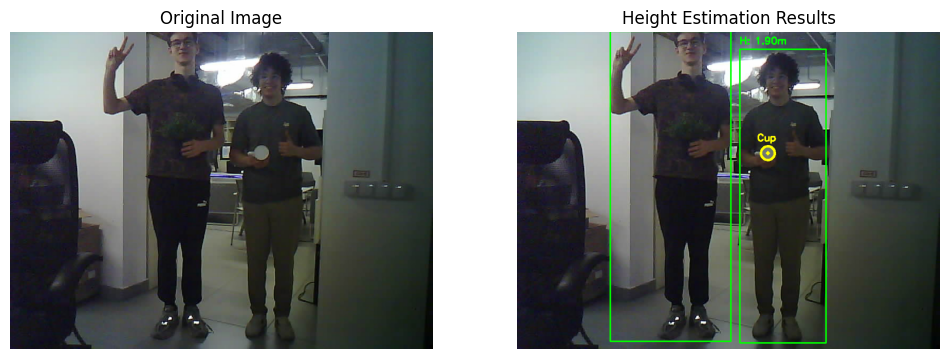

Processing image 4/8: L29.jpg
Cup detected: diameter = 28.0 px
Pixel-to-meter ratio: 0.003179 m/px
Person 1: pixel height = 581 px, estimated height = 1.85 m
Person 2: pixel height = 552 px, estimated height = 1.75 m
Person 1:
  Position: (177, 0), Size: 227×581 px
  Estimated height: 1.85 meters

Person 2:
  Position: (421, 34), Size: 165×552 px
  Estimated height: 1.75 meters



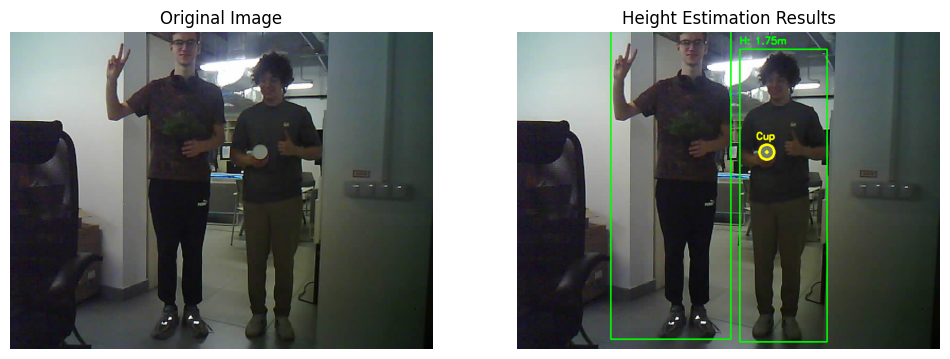

Processing image 5/8: L30.jpg
Cup detected: diameter = 30.0 px
Pixel-to-meter ratio: 0.002967 m/px
Person 1: pixel height = 574 px, estimated height = 1.70 m
Person 2: pixel height = 553 px, estimated height = 1.64 m
Person 1:
  Position: (246, 3), Size: 150×574 px
  Estimated height: 1.70 meters

Person 2:
  Position: (414, 32), Size: 174×553 px
  Estimated height: 1.64 meters



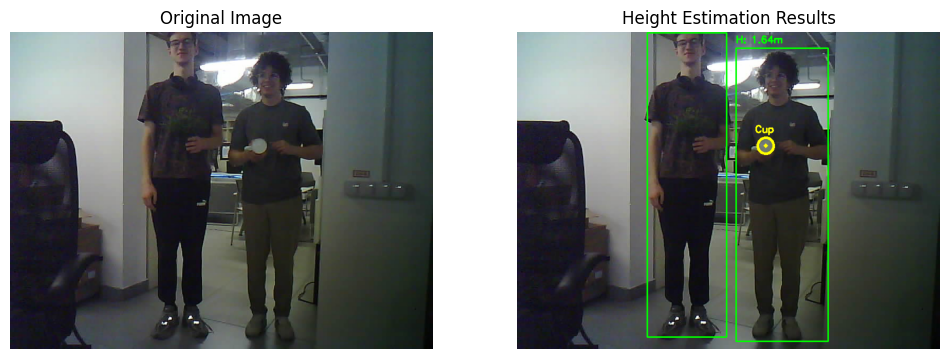

Processing image 6/8: L31.jpg
Cup detected: diameter = 28.0 px
Pixel-to-meter ratio: 0.003179 m/px
Person 1: pixel height = 572 px, estimated height = 1.82 m
Person 2: pixel height = 552 px, estimated height = 1.75 m
Person 1:
  Position: (247, 3), Size: 147×572 px
  Estimated height: 1.82 meters

Person 2:
  Position: (423, 35), Size: 166×552 px
  Estimated height: 1.75 meters



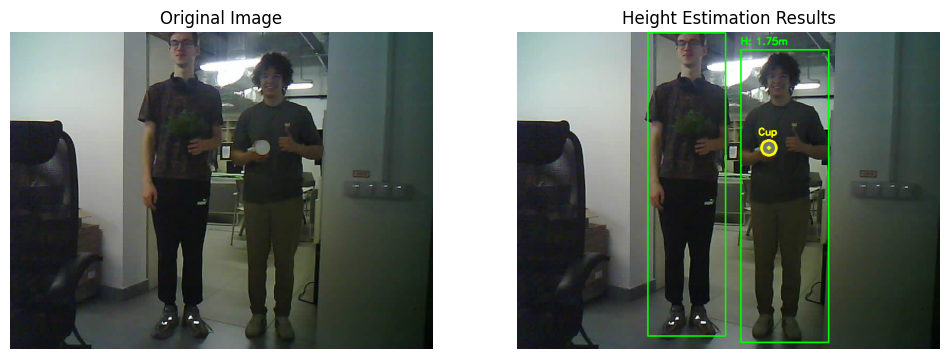

Processing image 7/8: L32.jpg
Cup detected: diameter = 30.0 px
Pixel-to-meter ratio: 0.002967 m/px
Person 1: pixel height = 552 px, estimated height = 1.64 m
Person 2: pixel height = 573 px, estimated height = 1.70 m
Person 1:
  Position: (425, 35), Size: 155×552 px
  Estimated height: 1.64 meters

Person 2:
  Position: (251, 4), Size: 145×573 px
  Estimated height: 1.70 meters



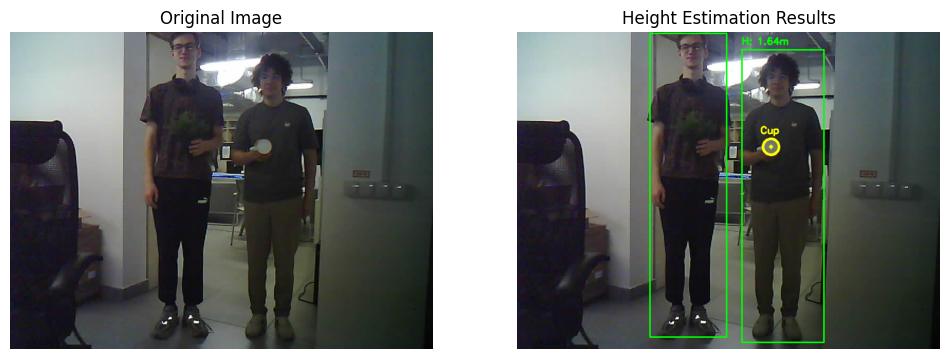

Processing image 8/8: L33.jpg
No cup circle detected


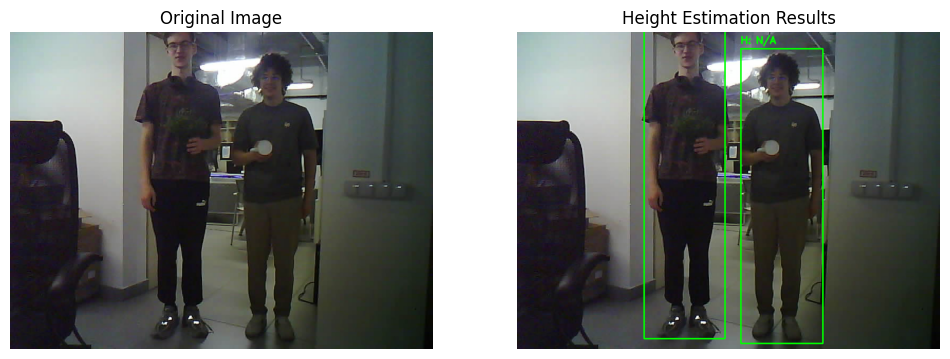

In [22]:
def detect_cup_circle(image):
    """Detect the circular bottom of a cup using Hough Circle Transform"""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (9, 9), 2)

    # Detect circles
    circles = cv2.HoughCircles(
        blurred,
        cv2.HOUGH_GRADIENT,
        dp=1,
        minDist=50, #Cups should be at least 50 pixels apart
        param1=50, #Moderate edge sensitivity for cup edges
        param2=30, #Relatively low threshold to detect faint cup circles
        minRadius=10, #Looking for cup bottoms ~20-100 pixels in diameter
        maxRadius=50
    )

    if circles is not None:
        circles = np.round(circles[0, :]).astype("int")
        largest_circle = max(circles, key=lambda x: x[2])
        return largest_circle

def compute_height_using_cup_reference(left_img, human_boxes, cup_diameter_m=0.089):
    height_estimates = []
    # Detect cup circle
    cup_circle = detect_cup_circle(left_img)
    if cup_circle is None:
      print("No cup circle detected")
      return [-1] * len(human_boxes), None

    x_c, y_c, r_c = cup_circle
    cup_diameter_px = 2 * r_c
    # Calculate pixel-to-meter ratio
    pixel_to_meter_ratio = cup_diameter_m / cup_diameter_px
    print(f"Cup detected: diameter = {cup_diameter_px:.1f} px")
    print(f"Pixel-to-meter ratio: {pixel_to_meter_ratio:.6f} m/px")
    # Estimate height for each person
    for i, box in enumerate(human_boxes):
        x, y, w, h = box
        person_height_px = h
        person_height_m = person_height_px * pixel_to_meter_ratio
        height_estimates.append(person_height_m)
        print(f"Person {i+1}: pixel height = {person_height_px} px, estimated height = {person_height_m:.2f} m")

    return height_estimates, cup_circle

def run_complete_analysis():
    # Load YOLO model
    net, output_layers, classes = load_yolo()
    # Load left images only (we don't need right images for height estimation)
    left_images = sorted(glob("/content/dataset/Dataset/personsDataset/L*.jpg"))
    # Process each left image
    for i, left_path in enumerate(left_images):
        print(f"Processing image {i+1}/{len(left_images)}: {os.path.basename(left_path)}")
        # Load original left image (no rectification)
        left_img = cv2.imread(left_path)
        # Detect humans on original image
        human_boxes = detect_humans_yolo(left_img, net, output_layers, classes)
        # Compute heights using cup reference on original image
        height_estimates, cup_circle = compute_height_using_cup_reference(left_img, human_boxes)
        # Visualize results on original image
        result_img = left_img.copy()

        # Draw cup circle
        if cup_circle is not None:
            x_c, y_c, r_c = cup_circle
            cv2.circle(result_img, (x_c, y_c), r_c, (0, 255, 255), 3)
            cv2.circle(result_img, (x_c, y_c), 2, (0, 255, 255), 3)
            cv2.putText(result_img, 'Cup', (x_c - 20, y_c - r_c - 10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 255), 2)

        # Draw person bounding boxes with height information
        for j, (box, height_est) in enumerate(zip(human_boxes, height_estimates)):
            x, y, w, h = box
            cv2.rectangle(result_img, (x, y), (x + w, y + h), (0, 255, 0), 2)

            height_text = f'H: {height_est:.2f}m' if height_est > 0 else 'H: N/A'
            cv2.putText(result_img, height_text, (x, y-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(left_img, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
        plt.title('Height Estimation Results')
        plt.axis('off')

        for j, (box, height_est) in enumerate(zip(human_boxes, height_estimates)):
            if height_est > 0:
                x, y, w, h = box
                print(f"Person {j+1}:")
                print(f"  Position: ({x}, {y}), Size: {w}×{h} px")
                print(f"  Estimated height: {height_est:.2f} meters")
                print()
        plt.show()

run_complete_analysis()

## Reflection (10%)

Answer in Markdown cell:
1. What were the main sources of error in your calibration and measurements?  
2. How could you improve your stereo setup to achieve more accurate depth results?


## Reflection

### 1. Main Sources of Error in Calibration and Measurements

**Calibration Errors:**
- **Checkerboard Detection Inaccuracy**: Small errors in corner detection using `cv2.findChessboardCorners()` accumulate during stereo calibration, affecting the fundamental matrix and rectification parameters
- **Lens Distortion**: While we corrected for radial and tangential distortion, residual distortion at image edges still causes slight misalignment in rectified images
- **Camera Synchronization**: Since we used separate cameras, minor timing differences between left and right image capture introduced small alignment errors
- **Baseline Measurement**: The physical distance between cameras (127mm) had measurement uncertainty, directly impacting depth calculation accuracy

**Measurement Errors:**
- **Disparity Map Noise**: The stereo matching algorithm produces noisy disparity maps
- **Bounding Box Inaccuracy**: YOLO bounding boxes don't perfectly fit human contours
- **Depth-Disparity Relationship**: The inverse relationship (Z ∝ 1/d) means small disparity errors cause large depth errors for distant objects
- **Cup Circle Detection**: Hough circle transform parameters (minRadius, maxRadius) needed manual tuning and sometimes detected false circles or missed the actual cup

### 2. Improvements for More Accurate Depth Results

- **Synchronized Cameras**: Use hardware-synchronized cameras or global shutter cameras to eliminate timing differences
- **Higher Resolution Sensors**: Increase image resolution for more precise corner detection and disparity calculation
- **Identical Lenses**: Use matched lens pairs with minimal distortion characteristics
- **Controlled Lighting**: Implement consistent lighting to reduce shadows and improve feature matching
- **Ground Truth Validation**: Collect ground truth depth measurements using LiDAR or known distances to validate and calibrate the system


---
###  Submission Instructions
- Submit this notebook with all code cells executed (file name should be YOUR_NAME_HW3).
- The code should be commented. (5%)
- Include a folder with your captured stereo images.
- Ensure all parameters are clearly documented.(5%)


# Useful resources :
- https://learnopencv.com/making-a-low-cost-stereo-camera-using-opencv/
- https://pub.towardsai.net/detecting-objects-with-yolov5-opencv-python-and-c-c7cf13d1483c
- https://learnopencv.com/introduction-to-epipolar-geometry-and-stereo-vision/